In [1]:
# This block load the images from YOUR google drive 
# This google drive should be the same as the configured in PMiru camera
# This block should me only called once.
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [33]:
!pip install git+https://github.com/elerac/polanalyser

# Libaries needed for the volumetric render to work 
import numpy as np
import cv2 as cv 
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import polanalyser as pa 
import json
import os

# This program creates Degree of Linear Polarization (DoLP) and Angle of Linear Polarization (AoLP) graphics 
# it uses the following libraty to calculate the Stokes vectors and create the graphs
# https://github.com/elerac/polanalyser/blob/master/examples/visualize_AoLP.py

# HERE ARE ALL THE INITIAL VARIABLES NEEDED TO MAKE THE VOLUMETRIC RENDERING
# where are the camera images (google drive path, just copy the path of the folder form the file explorer on the left. Right click, "Copy Path" )
PATH = '/content/gdrive/MyDrive/cube_20210806_1612_01'
# TODO get ANGLES AND COLOR_NAMES from the hypercube config file (JSON)
# Here you must define the REAL angles of polarized light
# ANGLES = np.deg2rad([0,25,50,75,100])
ANGLES = None
# COLOR ORDER FOR THE HYPERCUBE
# COLOR_NAMES = np.array([390,400,460,520,590,620,660,740,850,940,8000]) # Hypercube is order by color name
COLOR_NAMES = None

# If ANGLES and COLOR_NAMES are not given read them from JSON file
if ANGLES is None or COLOR_NAMES is None:
  f = open(os.path.join(PATH,"controlValues.json"))
  json_data = json.load(f)
  COLOR_NAMES = json_data["colors"][0]
  COLOR_NAMES = np.sort(COLOR_NAMES)
  a_start = json_data["angles"][0]["start"]
  a_stop = json_data["angles"][0]["stop"]
  a_step = json_data["angles"][0]["step"] 
  ANGLES = []
  for a in range(a_start,a_stop,a_step):
    ANGLES.append(np.deg2rad(a))
  ANGLES = np.array(ANGLES)


# Function to convert polarizer graphs to uint8
def convert_u8(image, gamma=1/2.2):
    image = np.clip(image, 0, 255).astype(np.uint8)
    lut = (255.0 * (np.linspace(0, 1, 256) ** gamma)).astype(np.uint8)
    return lut[image]


  Cloning https://github.com/elerac/polanalyser to /tmp/pip-req-build-97lbh2ub
  Running command git clone -q https://github.com/elerac/polanalyser /tmp/pip-req-build-97lbh2ub



DoLP (Degree of Lineal Polarization) 390 µm
/////////////////////////////////////////////////////////////////////


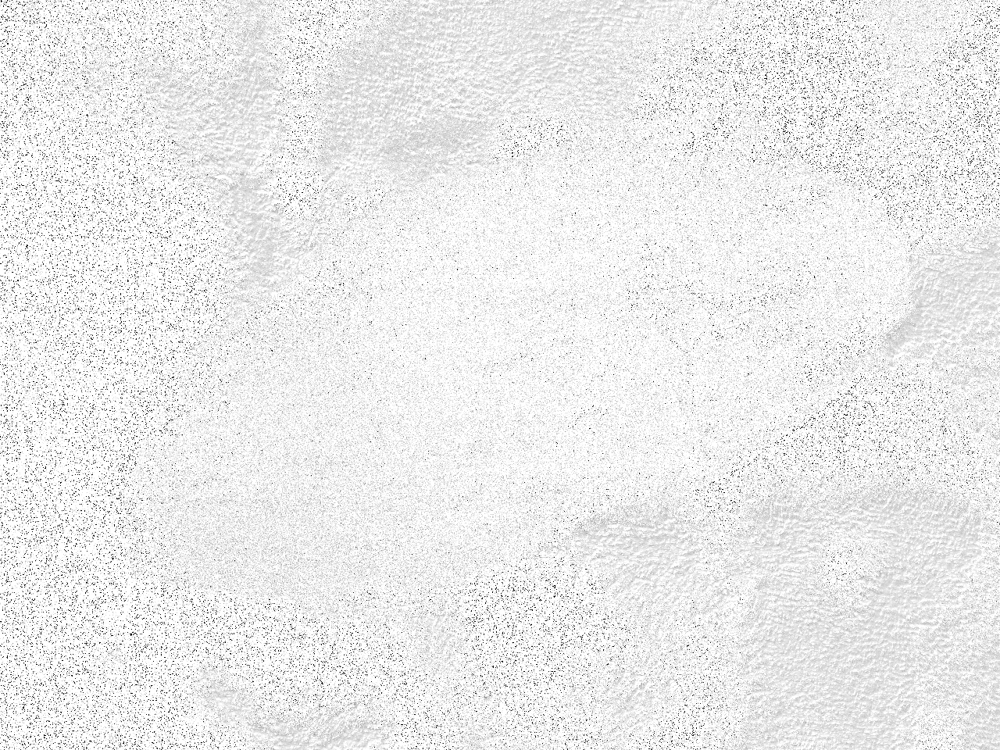


AoLP (Angle of Lineal Polarization) 390 µm
/////////////////////////////////////////////////////////////////////


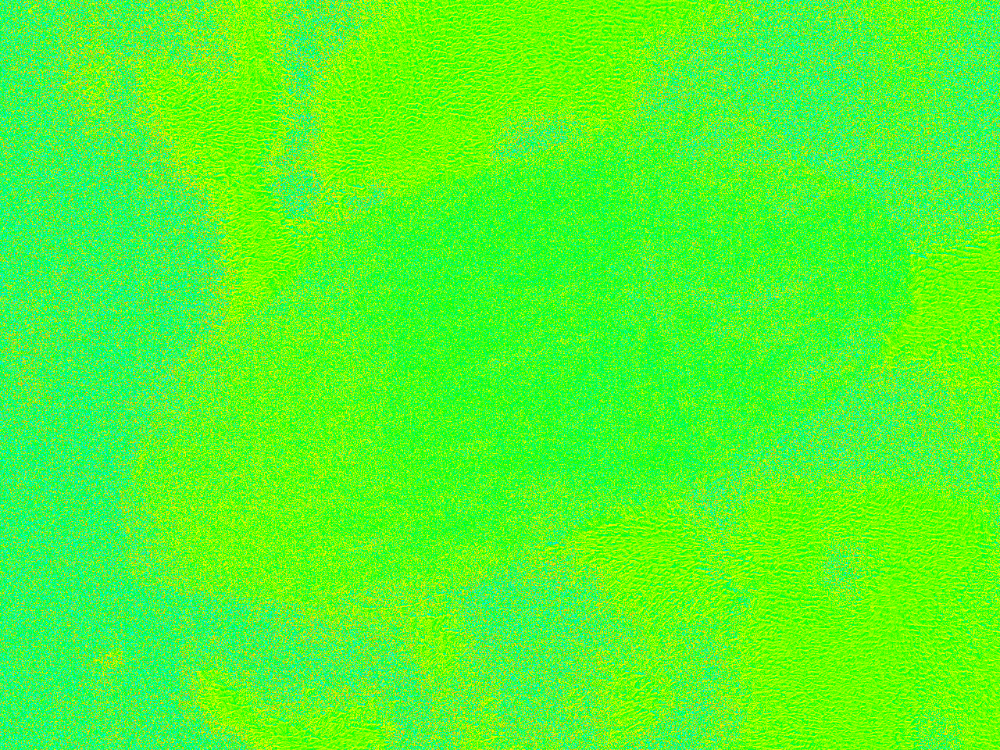


DoLP (Degree of Lineal Polarization) 400 µm
/////////////////////////////////////////////////////////////////////


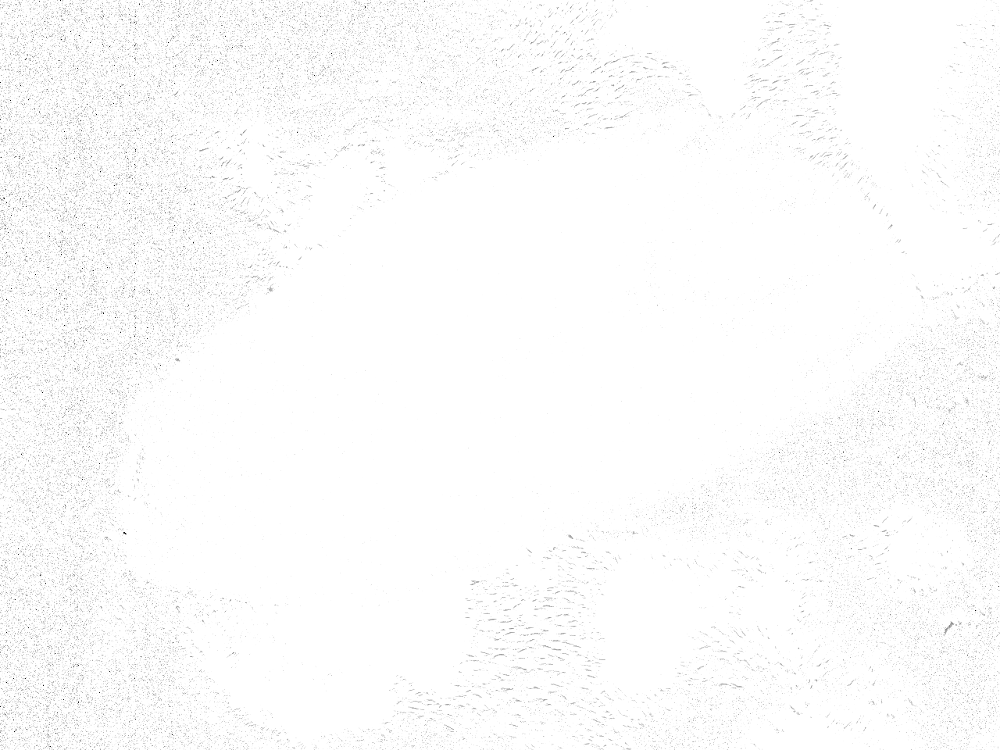


AoLP (Angle of Lineal Polarization) 400 µm
/////////////////////////////////////////////////////////////////////


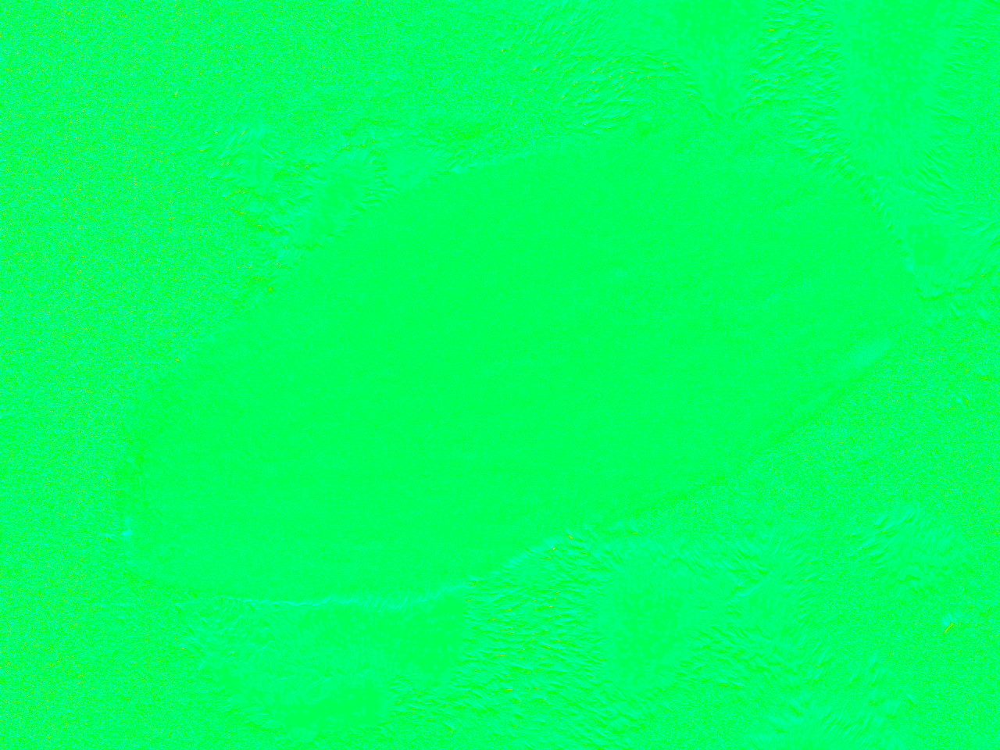


DoLP (Degree of Lineal Polarization) 460 µm
/////////////////////////////////////////////////////////////////////


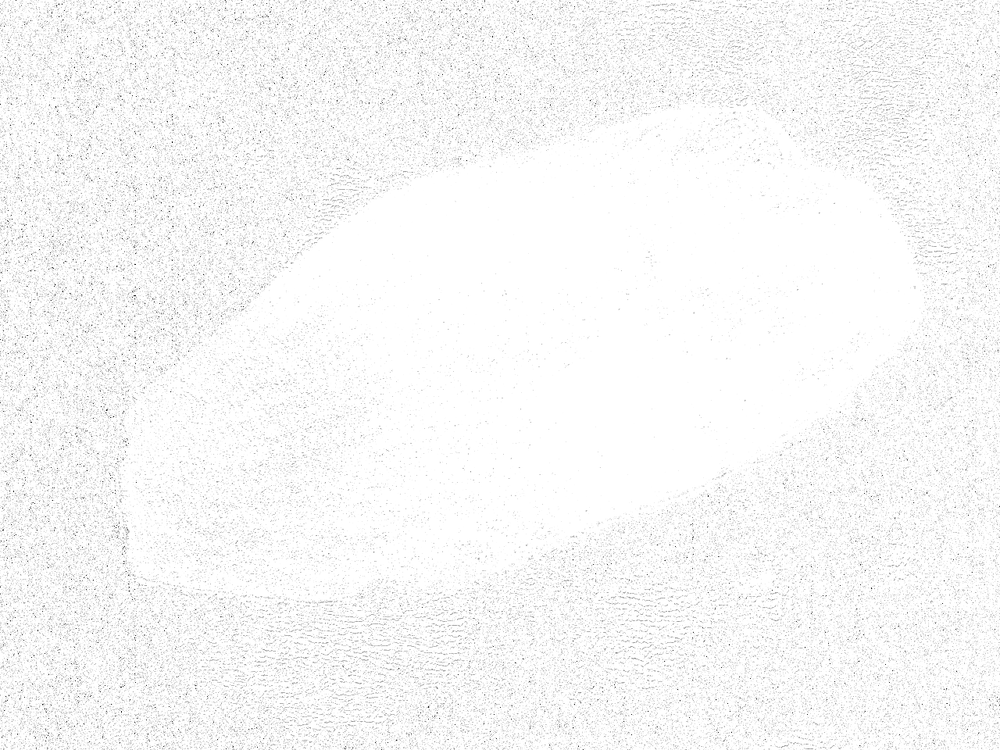


AoLP (Angle of Lineal Polarization) 460 µm
/////////////////////////////////////////////////////////////////////


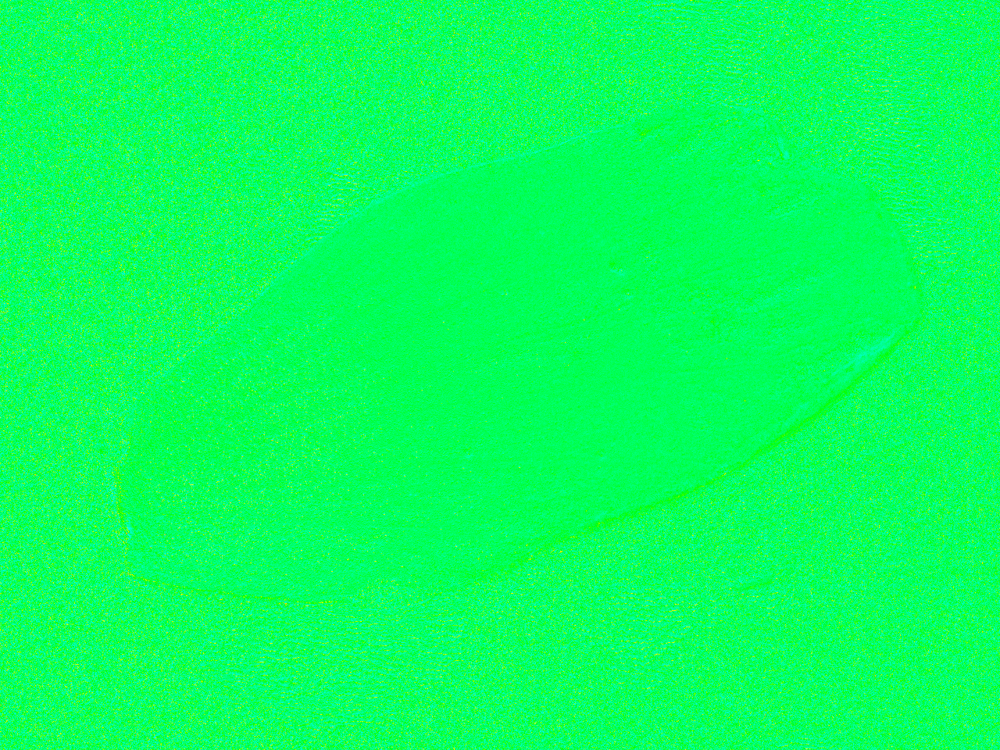


DoLP (Degree of Lineal Polarization) 520 µm
/////////////////////////////////////////////////////////////////////


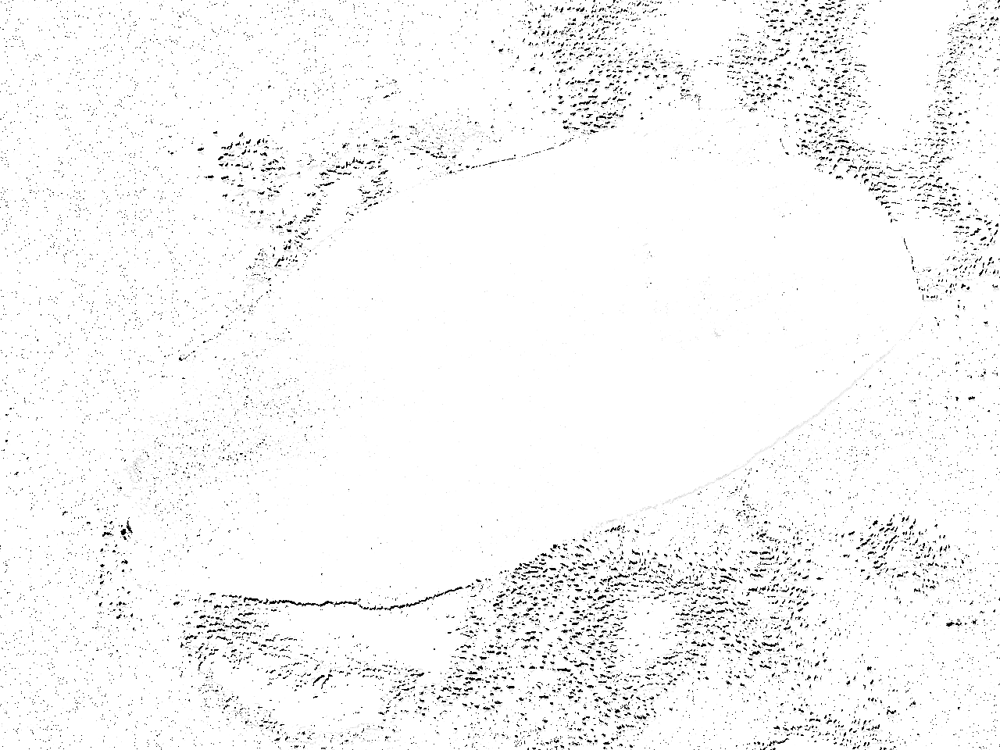


AoLP (Angle of Lineal Polarization) 520 µm
/////////////////////////////////////////////////////////////////////


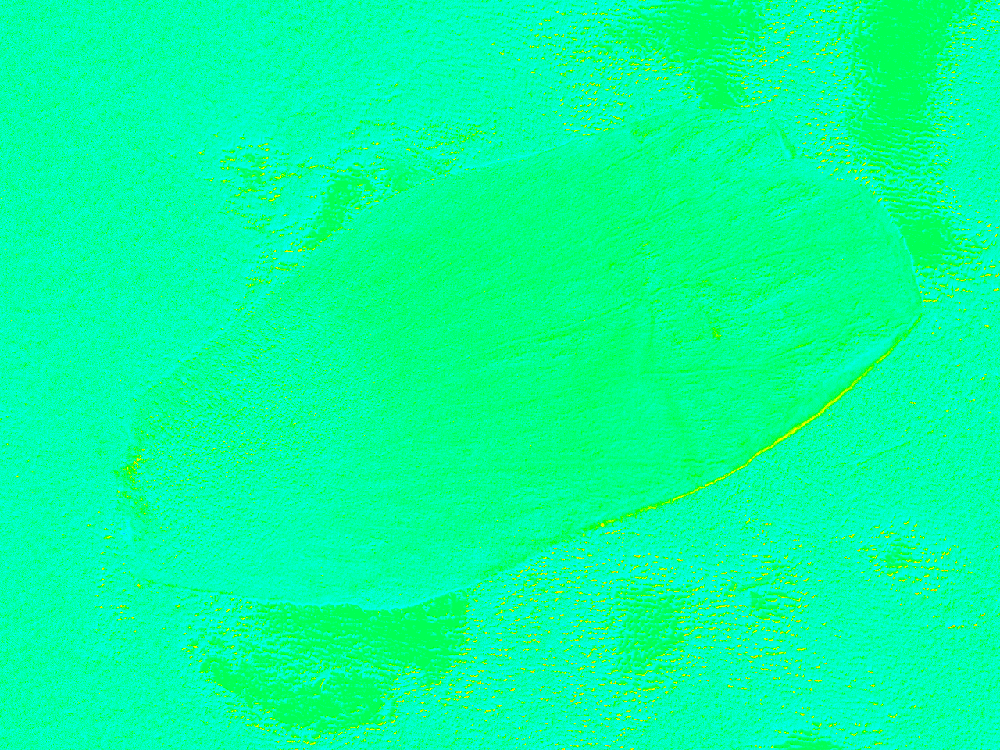


DoLP (Degree of Lineal Polarization) 590 µm
/////////////////////////////////////////////////////////////////////


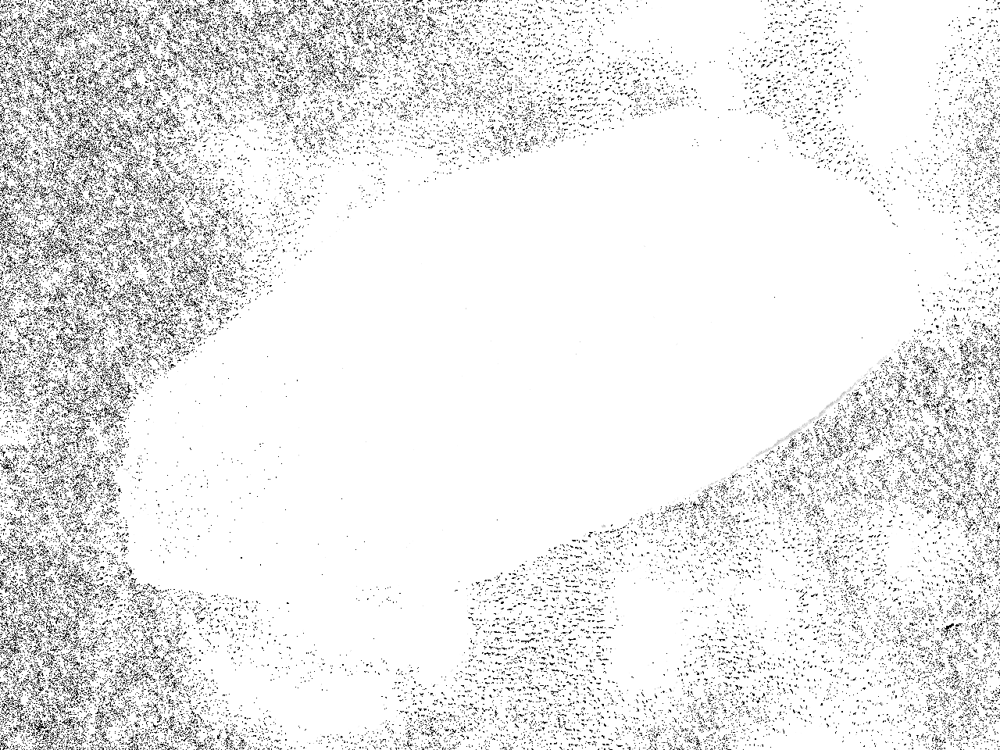


AoLP (Angle of Lineal Polarization) 590 µm
/////////////////////////////////////////////////////////////////////


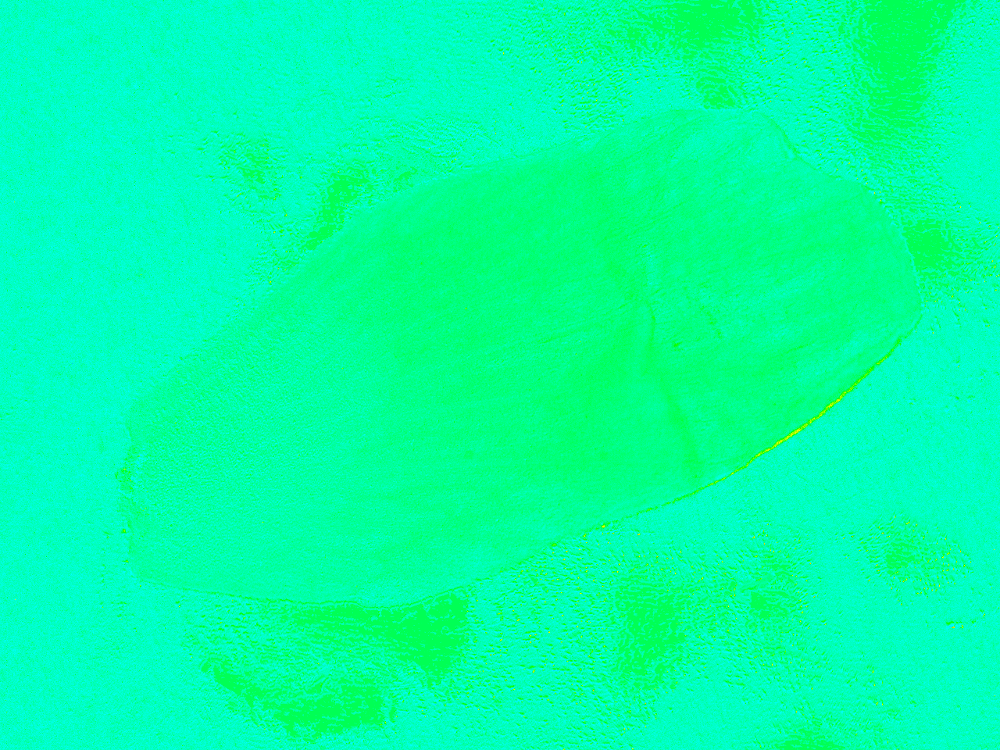


DoLP (Degree of Lineal Polarization) 620 µm
/////////////////////////////////////////////////////////////////////


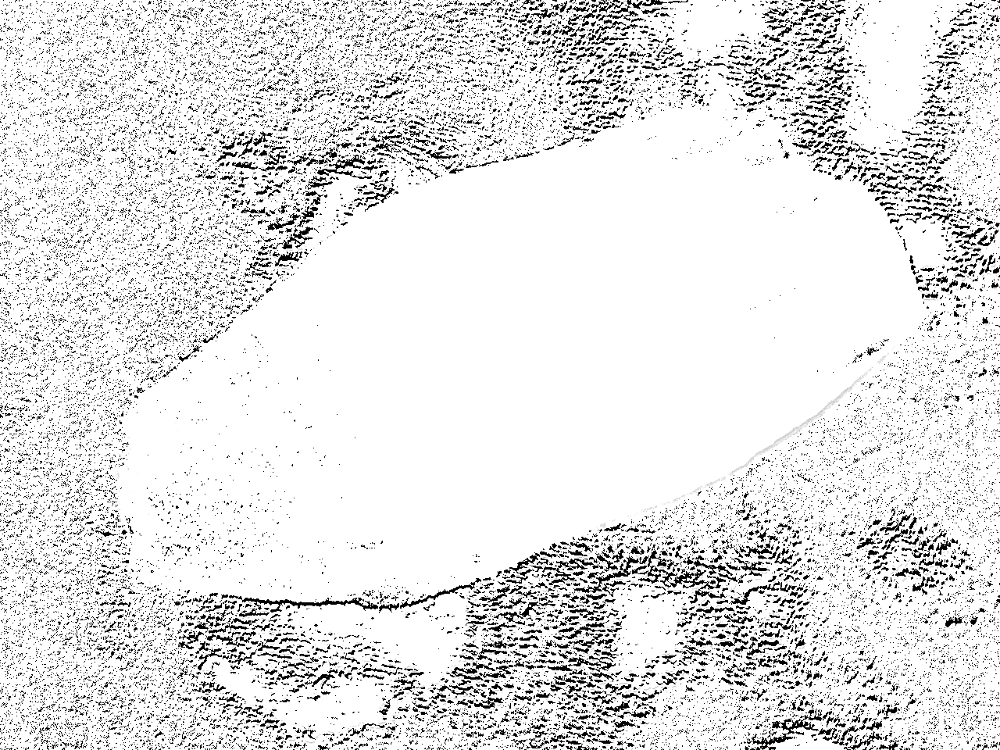


AoLP (Angle of Lineal Polarization) 620 µm
/////////////////////////////////////////////////////////////////////


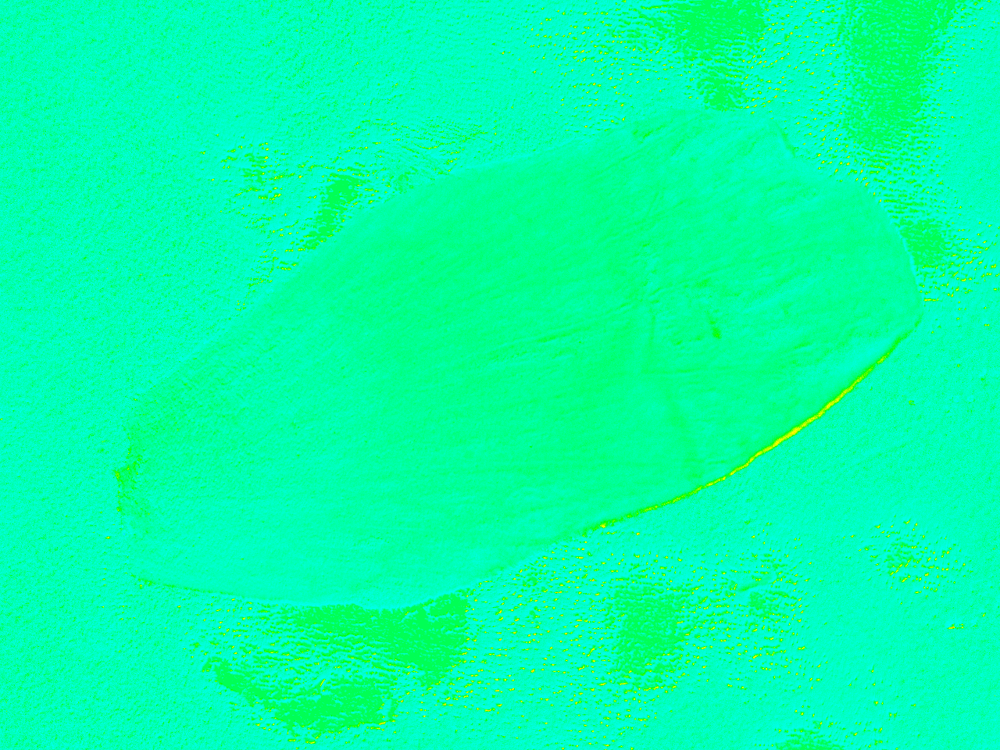


DoLP (Degree of Lineal Polarization) 660 µm
/////////////////////////////////////////////////////////////////////


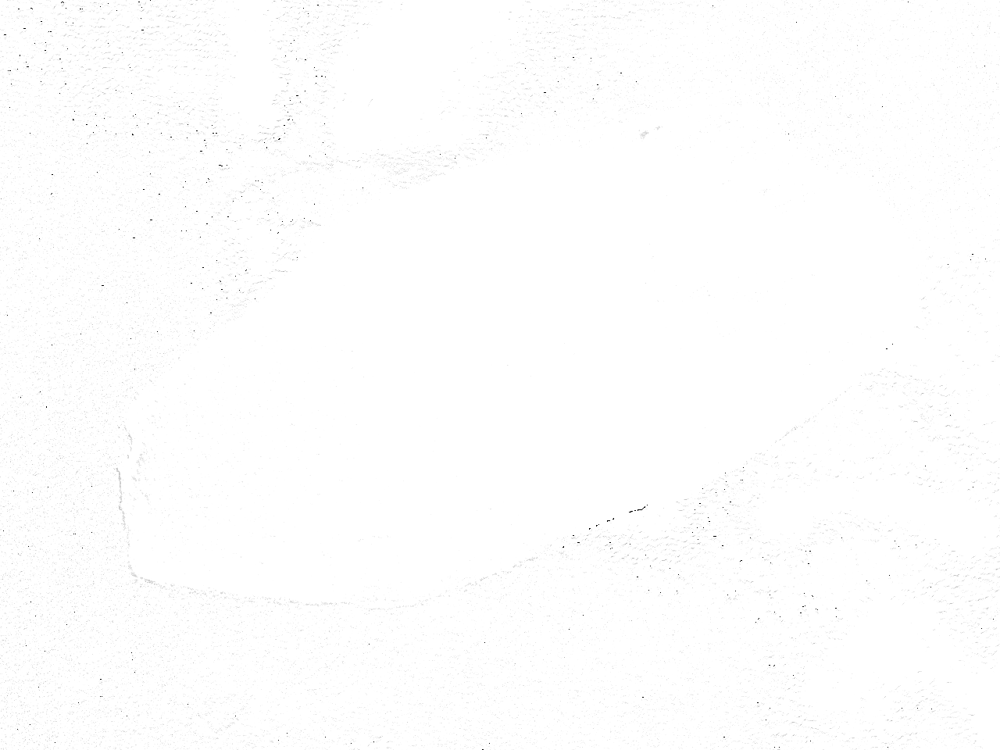


AoLP (Angle of Lineal Polarization) 660 µm
/////////////////////////////////////////////////////////////////////


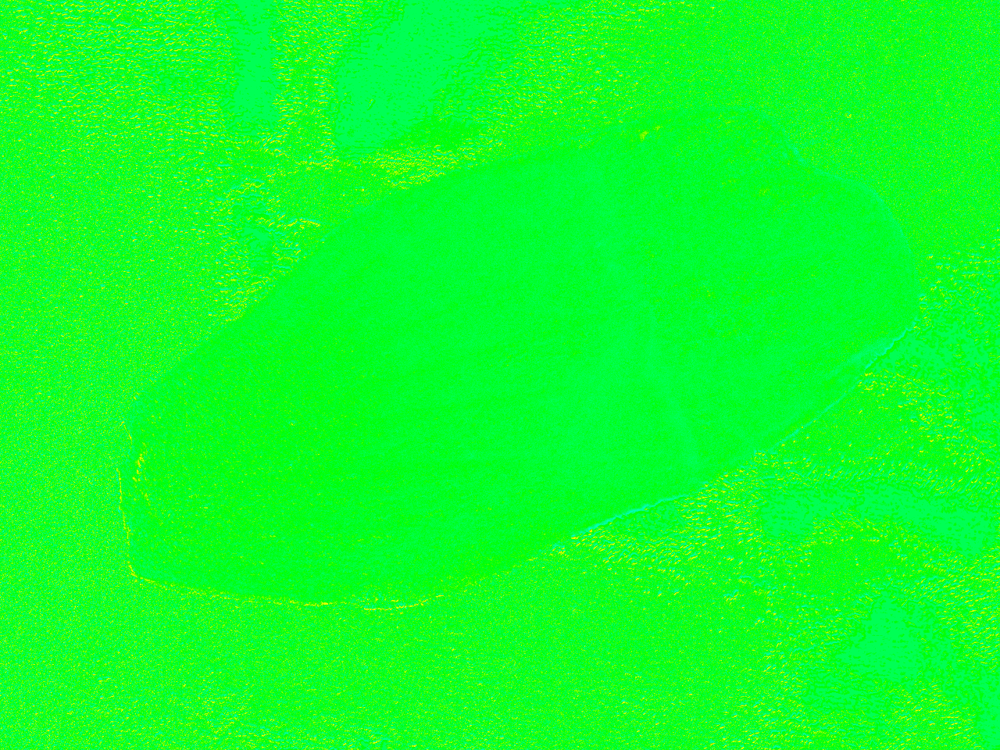


DoLP (Degree of Lineal Polarization) 740 µm
/////////////////////////////////////////////////////////////////////


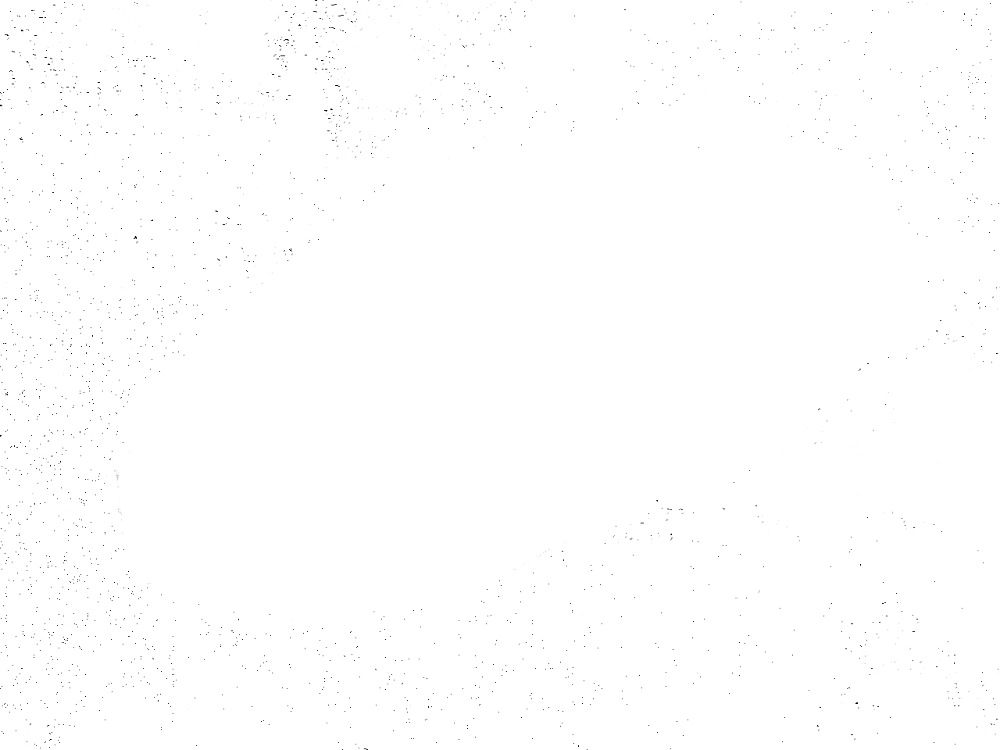


AoLP (Angle of Lineal Polarization) 740 µm
/////////////////////////////////////////////////////////////////////


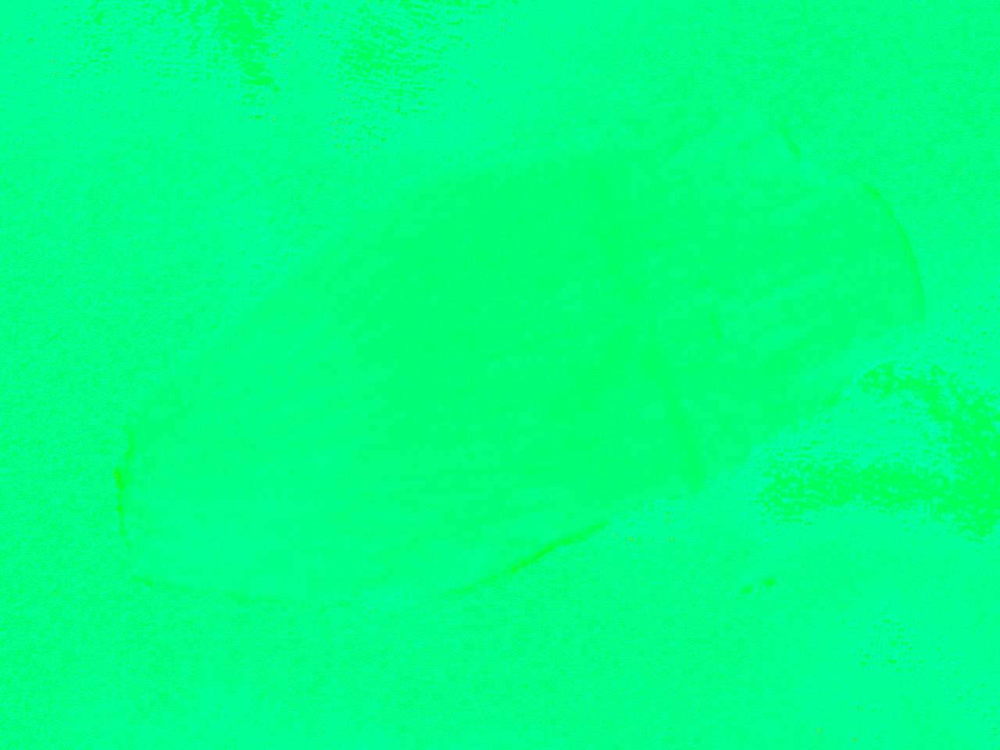


DoLP (Degree of Lineal Polarization) 850 µm
/////////////////////////////////////////////////////////////////////


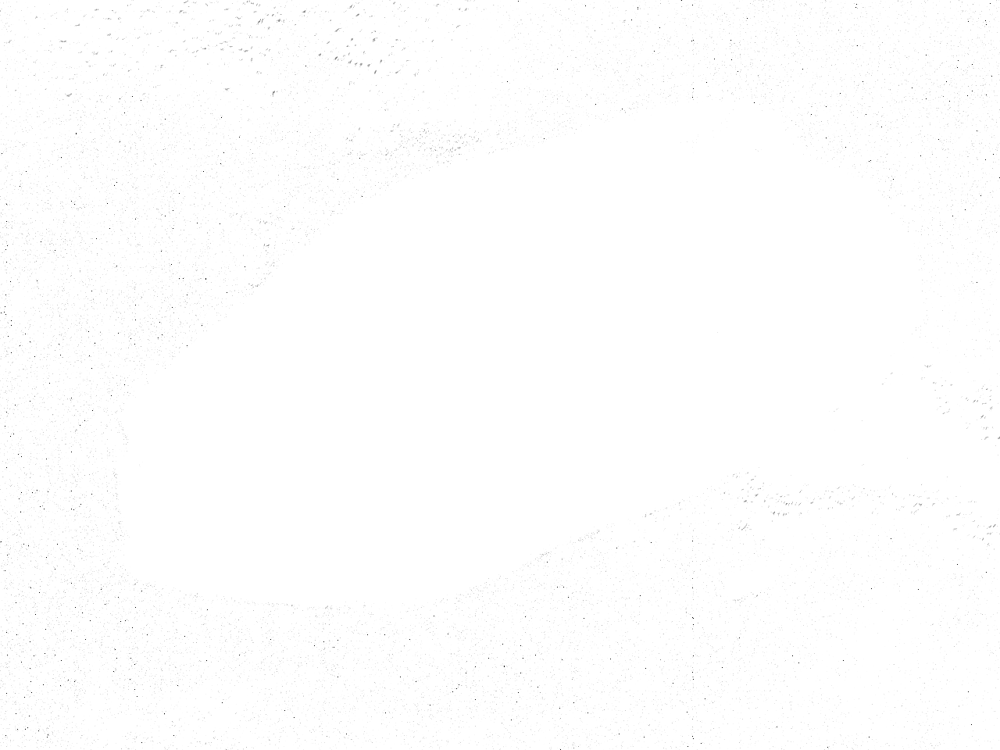


AoLP (Angle of Lineal Polarization) 850 µm
/////////////////////////////////////////////////////////////////////


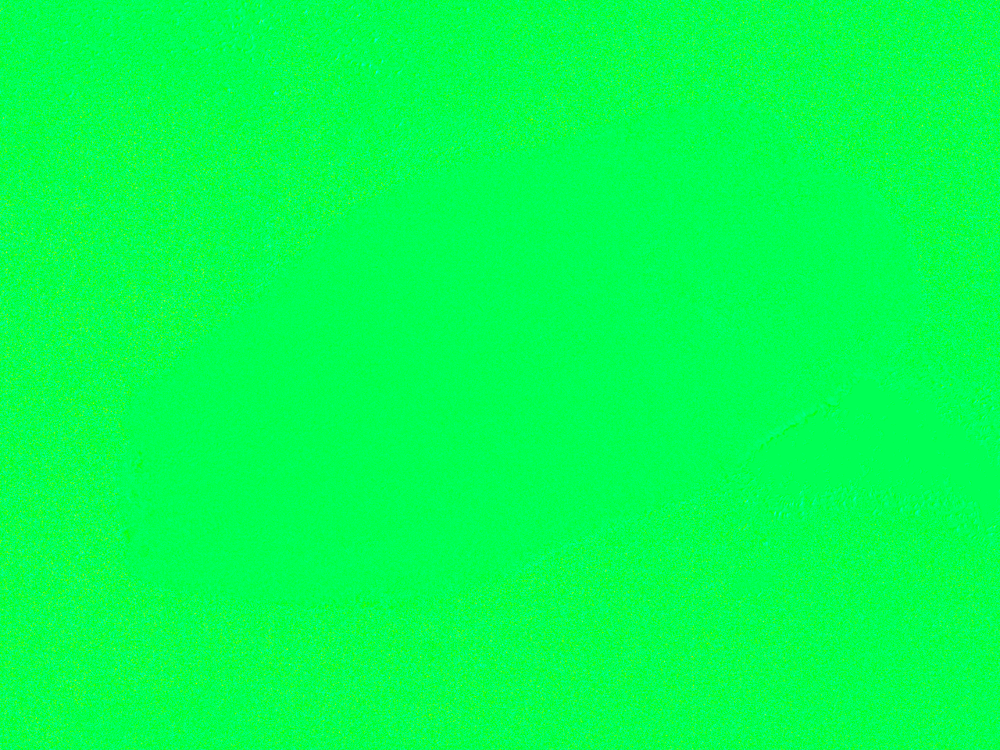


DoLP (Degree of Lineal Polarization) 940 µm
/////////////////////////////////////////////////////////////////////


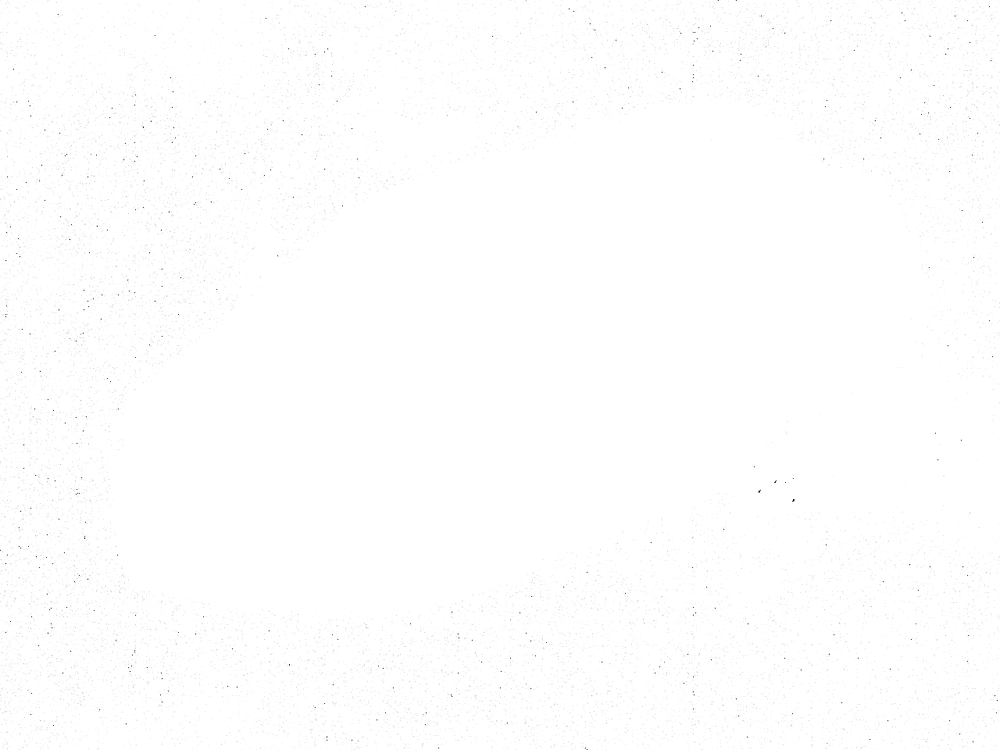


AoLP (Angle of Lineal Polarization) 940 µm
/////////////////////////////////////////////////////////////////////


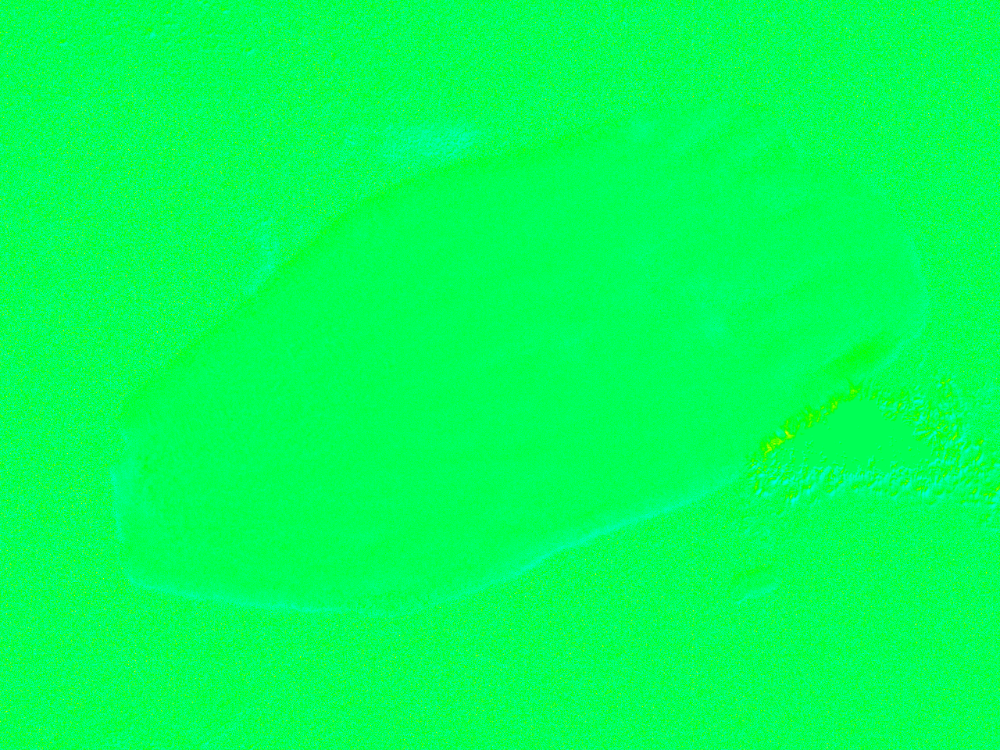


DoLP (Degree of Lineal Polarization) 8000 µm
/////////////////////////////////////////////////////////////////////


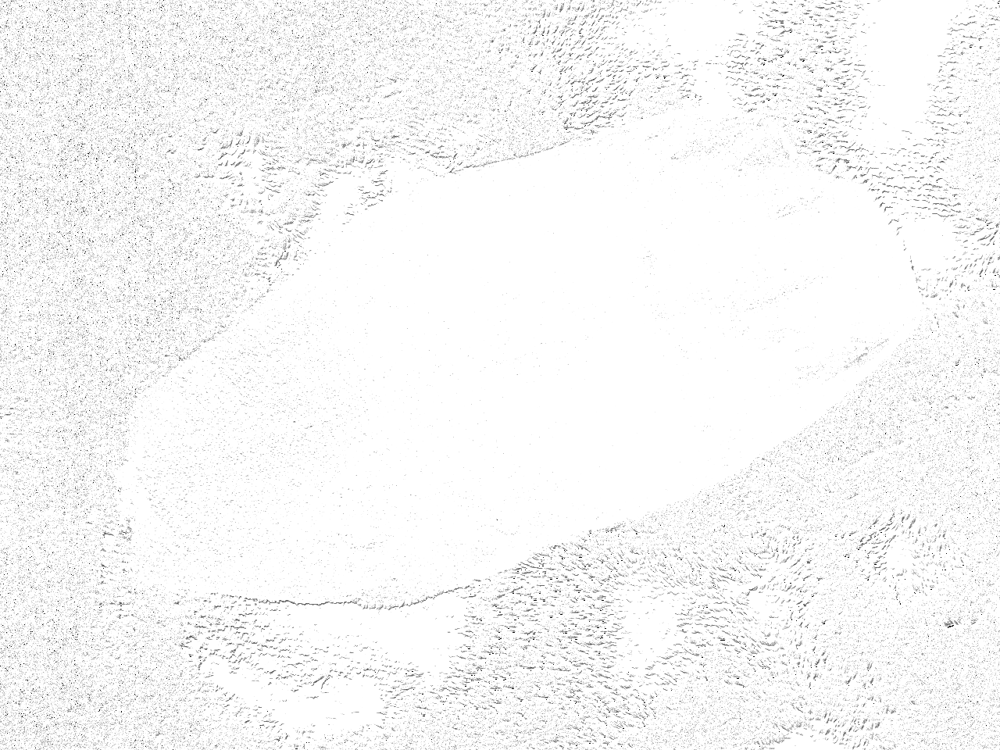


AoLP (Angle of Lineal Polarization) 8000 µm
/////////////////////////////////////////////////////////////////////


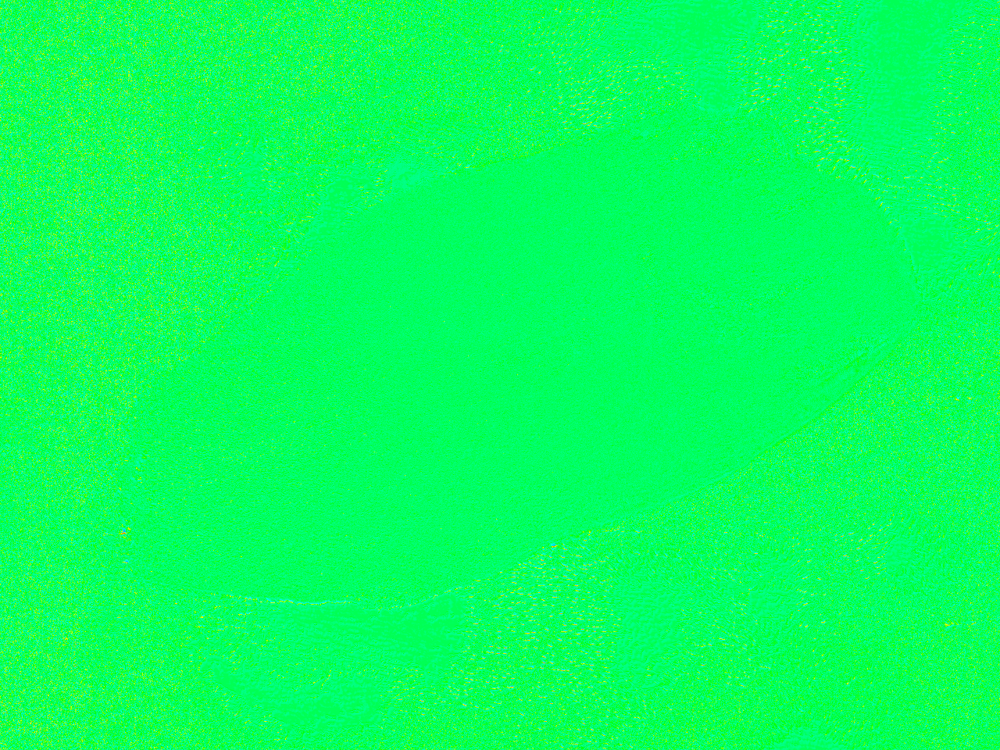

In [34]:
# THIS BLOCK CREATES THE AOLP AND DOLP IMAGES FOR THE 3D RENDER

# Build the hypercube arranged by color value
def getHyperCube (col_index):
    cname = COLOR_NAMES[col_index] 

    # List files by color order
    aIndex = 0
    for filename in os.listdir(PATH):
        fname, ext = os.path.splitext(filename)
        if ext == '.tiff' and  fname.find('c'+str(cname)) != -1:

            img = cv.imread(os.path.join(PATH,filename),-1)

            # Denoise the images
            # img = cv.normalize(img, None, 0, 255, cv.NORM_MINMAX, cv.CV_8U)  #conver to uinit8bit image
            # img = cv.fastNlMeansDenoising(img)   #apply NL means for denoise
            
            if aIndex == 0:  # Create a blank hypercube on memory
                hypercube = np.zeros((img.shape[0], img.shape[1], len(ANGLES)), dtype=img.dtype)

            hypercube [:,:,aIndex] = img
            aIndex = aIndex + 1

    return hypercube

# Calculates the AoLP of the cutted images
def calcPola():    
    aolp_path = os.path.join(PATH, 'aolp')
    if not os.path.isdir(aolp_path):  # Create folder if not exists
        os.mkdir(aolp_path)

    dolp_path = os.path.join(PATH, 'dolp')
    if not os.path.isdir(dolp_path):  # Create folder if not exists
        os.mkdir(dolp_path)


    for c_index, c_name in enumerate(COLOR_NAMES):
        hypercube = getHyperCube(c_index)

        # Calculate the Stokes vector per-pixel
        img_stokes = pa.calcStokes(hypercube, ANGLES)

        # Convert Stokes vector to meaningful values
        img_DoLP = pa.cvtStokesToDoLP(img_stokes) # 0~1
        img_AoLP = pa.cvtStokesToAoLP(img_stokes) # 0~pi

        # Convert to a image format 
        img_DoLP = convert_u8(img_DoLP*255, gamma=1) 
        img_AoLP = pa.applyColorToAoLP(img_AoLP)

        # Show pictures on the screen
        print()
        print("DoLP (Degree of Lineal Polarization) " + str(COLOR_NAMES[c_index]) + " µm" )
        print("/////////////////////////////////////////////////////////////////////")
        cv2_imshow(img_DoLP)

        print()
        print("AoLP (Angle of Lineal Polarization) " + str(COLOR_NAMES[c_index]) + " µm" )
        print("/////////////////////////////////////////////////////////////////////")
        cv2_imshow(img_AoLP)

        # Save the images on disk
        cv.imwrite( os.path.join(dolp_path, "img_dolp_c" + str(COLOR_NAMES[c_index]) + ".png" ) ,  img_DoLP)
        cv.imwrite( os.path.join(aolp_path, "img_aolp_c" + str(COLOR_NAMES[c_index]) + ".png" ) ,  img_AoLP)

# call the function to create the DOLP and AOLP images 
calcPola()

In [12]:
# IMPORTS FOR THE VOLUME RENDER (plotly)
import plotly
import plotly.graph_objs as go

VOL_SCALE_FACTOR = 10

dim_x = None; dim_y = None; dim_z = None;

# Apply the given mask to isolate the volume to be render
def applyMask(img,mask):
    cutted = cv.bitwise_and(img, img, mask=mask)  # Zero anything outside the mask
    return cutted

# Calculates hypercubes again and computes AoLP and DoLP again 
# Then creates the volume data structures for both AoLP and DoLP
def get_data_matrix( ):
  global dim_x, dim_y, dim_z
  # Open mask 
  mask = cv.imread(os.path.join(PATH, 'mask.tiff'), 0)
  mask = cv.resize(mask, (mask.shape[1]//VOL_SCALE_FACTOR, mask.shape[0]//VOL_SCALE_FACTOR), interpolation = cv.INTER_CUBIC )

  dim_x = mask.shape[1]
  dim_y = mask.shape[0]
  dim_z = len(COLOR_NAMES)

  data_matrix_aolp =  np.zeros((dim_x,dim_y,dim_z), dtype=np.float)    # z, y, x
  data_matrix_dolp =  np.zeros((dim_x,dim_y,dim_z), dtype=np.float)    # z, y, x
  for c_index, c_name in enumerate(COLOR_NAMES):
    max_aolp_val = 0;  max_dolp_val = 0
    hypercube = getHyperCube(c_index)

    # Calculate the Stokes vector per-pixel
    img_stokes = pa.calcStokes(hypercube, ANGLES)

    # Convert Stokes vector to meaningful values
    img_DoLP = pa.cvtStokesToDoLP(img_stokes) # 0~1
    img_AoLP = pa.cvtStokesToAoLP(img_stokes) # 0~pi

    img_DoLP = cv.resize(img_DoLP, (img_DoLP.shape[1]//VOL_SCALE_FACTOR, img_DoLP.shape[0]//VOL_SCALE_FACTOR), interpolation = cv.INTER_CUBIC )
    img_AoLP = cv.resize(img_AoLP, (img_AoLP.shape[1]//VOL_SCALE_FACTOR, img_AoLP.shape[0]//VOL_SCALE_FACTOR), interpolation = cv.INTER_CUBIC )

    img_DoLP = applyMask(img_DoLP, mask)
    img_AoLP = applyMask(img_AoLP, mask)

    for x in range(dim_x):
      for y in range(dim_y):
          data_matrix_dolp[x][y][c_index] = img_DoLP[y][x]
          if data_matrix_dolp[x][y][c_index] > max_dolp_val:
              max_dolp_val = data_matrix_dolp[x][y][c_index]

          data_matrix_aolp[x][y][c_index] = img_AoLP[y][x]
          if data_matrix_aolp[x][y][c_index] > max_aolp_val:
              max_aolp_val = data_matrix_aolp[x][y][c_index]

    # VALUES MUST BE NORMALIZED FOR VOLUME RENDERING (0 to 1 is preferable)
    data_matrix_dolp[:dim_x, :dim_y, c_index] = data_matrix_dolp[:dim_x, :dim_y, c_index]  
    data_matrix_aolp[:dim_x, :dim_y, c_index] = data_matrix_aolp[:dim_x, :dim_y, c_index]  / max_aolp_val
    # print (max_aolp_val)
    # print (max_dolp_val)

  return [data_matrix_dolp, data_matrix_aolp]
          

# PLOT THE VOLUME DATA WITH PLOTLY
def create_plot(data, colors):
  global dim_x, dim_y, dim_z
  X, Y, Z = np.mgrid[:dim_x, :dim_y, :dim_z]
  c_names = [str(int) + 'µm'  for int in COLOR_NAMES]
  fig = go.Figure(data=go.Volume(
      x=X.flatten(), y=Y.flatten(), z=Z.flatten(),
      value=data.flatten(),
      isomin=0.01,
      isomax=1.0,
      opacity=0.3,
      surface_count=7,
      colorscale='RdYlBu',
      reversescale=True
      # caps= dict(x_show=False, y_show=False, z_show=False) # no caps
      ))

  fig.update_layout(scene_camera = dict(
      up=dict(x=0, y=-1, z=0),
      center=dict(x=0, y=0, z=0),
      eye=dict(x=0, y=0, z=-2.5)), 
      scene = dict(
                    zaxis = dict(
                        ticktext= c_names,
                        tickvals= np.arange(len(colors)) ),
                  ),

      scene_xaxis_showticklabels=True,
      scene_yaxis_showticklabels=True,
      scene_zaxis_showticklabels=True
  )

  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

  fig.layout.autosize = True
  return fig

# data = get_data_matrix(DOLP_PATH)
# fig = create_plot(data, COLOR_NAMES)
# fig.show()

# data = get_data_matrix(AOLP_PATH)
# fig = create_plot(data, COLOR_NAMES)
# fig.show()

data = get_data_matrix()
fig = create_plot(data[0], COLOR_NAMES)
fig.show()
fig = create_plot(data[1], COLOR_NAMES)
fig.show()

